In [1]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

### add a random seed

In [2]:
np.random.seed(100)

## environment

In [3]:
class Environment:
    def __init__(self, T_DAYS=10, UP=1.2, DOWN=0.8, PROB_UP=0.9, K = 1, Sigma = 1):
        self.T_DAYS = T_DAYS
        self.UP = UP
        self.DOWN = DOWN
        self.PROB_UP = PROB_UP
        self.DIRECTIONS = [self.UP, self.DOWN]
        self.ALL_STATES, self.ALL_END_STATES = self._create_all_states()
        self.DIRECTION2PROB = self._create_direction2prob()
        self.STATE2Stock_PRICE = self._calculate_prices_of_states()
        
        self.K = K
        self.Sigma = Sigma
        self.STATE2Option_PRICE = self._calculate_option_prices_of_states()
        
    def _create_all_states(self):
        state_len = 2**self.T_DAYS - 1
        inter_state_len = 2**(self.T_DAYS-1) - 1
        return [np.arange(state_len)+1, np.arange(inter_state_len, state_len)+1]
    

        
        
    def _create_direction2prob(self): #direction prob dictionary for binomial model
        direction2prob = dict()
        direction2prob[self.DIRECTIONS[0]] = self.PROB_UP
        direction2prob[self.DIRECTIONS[1]] = 1 - self.PROB_UP
        return direction2prob
    
    def _calculate_prices_of_states(self): #calculate stock price at each state
        price_at_day1 = 1
        state2price_dict = dict()
        for each_state in self.ALL_STATES:
            path_str = str(bin(each_state))[2:]
#             print(path_str)
            cnt_1 = 0 #how many times down
            for i in range(1, len(path_str)):
                cnt_1 += int(path_str[i])
            cnt_0 = len(path_str) - 1 - cnt_1 #how many times up
#             print(cnt_0, cnt_1, len(path_str))
            each_price = price_at_day1 * self.UP**cnt_0 * self.DOWN**cnt_1 #calculate prices
#             print(each_price)
            state2price_dict[each_state] = each_price
        return state2price_dict
    
    def _calculate_option_prices_of_states(self):
        state2option_dict = dict()
        N_states = self.ALL_STATES.shape[0]
        state_i = N_states
        while(state_i>0):
            #print(state_i)
            each_state = state_i
            path_str = str(bin(each_state))[2:]
#             print(path_str)
            if len(path_str) == self.T_DAYS: #terminal states
                stock_price = self.STATE2Stock_PRICE[state_i]
                option_price = max((-stock_price + self.K), 0)
                print(option_price)
            else: #intermediate states
                option_price = 0
            state2option_dict[state_i] = option_price
            state_i = state_i - 1
        return state2option_dict
    
    def show_environment(self):
        print("ALL STATES: ", self.ALL_STATES)
        print("ALL END STATES: ", self.ALL_END_STATES)
        print("Binary state tree: ")
        for each in self.ALL_STATES:
            print(str(bin(each))[2:])
        print("DIRECTION2PROB: ", self.DIRECTION2PROB)
        print("STATE2State_PRICE: ", self.STATE2Stock_PRICE)
        print("STATE2Option_PRICE: ", self.STATE2Option_PRICE)
        
    def _reward(self, current_state, current_action): #reward function
        rnumber = np.random.rand()
        if rnumber < self.PROB_UP:
            direction = self.UP
        else:
            direction = self.DOWN
        
        current_stock_price = self.STATE2Stock_PRICE[current_state]
        next_state = self._next_state(current_state)
        next_stock_price = self.STATE2Stock_PRICE[next_state]
        #print("next_state: ", next_state)
        PL_stock = (next_stock_price - current_stock_price) * current_action
        PL_option = self.STATE2Option_PRICE[next_state]
        total_PL = PL_stock + PL_option
        return -np.square(total_PL)

    def _next_state(self, state): #indicate the next state for a given state
        rnumber = np.random.rand()
        if rnumber < self.PROB_UP:
            direction = self.UP
        else:
            direction = self.DOWN
        
        if direction >= 1:
            next_state = state * 2 + 1 #if up, ->
        else:
            next_state = state * 2  #if down, -> and +1
        return int(next_state)
    
    def step(self, state, action): #given this state, action, return next state and this reward in this direction situation
        state_current_price = self.STATE2Stock_PRICE[state]
        next_state_ = self._next_state(state)
        #print("next_state_:", next_state_)
        if next_state_ not in self.ALL_STATES:
            next_state_ = state
            reward_ = 0
        else:
            reward_ = self._reward(state, action)
        return next_state_, reward_

    

### environment instance

In [4]:
env = Environment(T_DAYS=10, UP=1.2, DOWN=0.8, PROB_UP=0.5, K=1)
env.show_environment()

0.8657822719999999
0.7986734079999999
0.7986734079999999
0.698010112
0.7986734079999999
0.698010112
0.698010112
0.5470151679999999
0.7986734079999999
0.698010112
0.698010112
0.5470151679999999
0.698010112
0.5470151679999999
0.5470151679999999
0.3205227519999999
0.7986734079999999
0.698010112
0.698010112
0.5470151679999999
0.698010112
0.5470151679999999
0.5470151679999999
0.3205227519999999
0.698010112
0.5470151679999999
0.5470151679999999
0.3205227519999999
0.5470151679999999
0.3205227519999999
0.3205227519999999
0
0.7986734079999999
0.698010112
0.698010112
0.5470151679999999
0.698010112
0.5470151679999999
0.5470151679999999
0.3205227519999999
0.698010112
0.5470151679999999
0.5470151679999999
0.3205227519999999
0.5470151679999999
0.3205227519999999
0.3205227519999999
0
0.698010112
0.5470151679999999
0.5470151679999999
0.3205227519999999
0.5470151679999999
0.3205227519999999
0.3205227519999999
0
0.5470151679999999
0.3205227519999999
0.3205227519999999
0
0.3205227519999999
0
0
0
0.798673

In [5]:
env.ALL_STATES.shape[0]

1023

## Agent with policy gradient or delta hedging

In [6]:
class Agent:
    def __init__(self, ENV, DISCOUNT = 1, alpha = 0.01):
        self.ENV = ENV
        self.DISCOUNT = DISCOUNT
        
        self.theta_mu = np.array(np.random.rand(ENV.ALL_STATES.shape[0]))
        self.theta_sigma = np.array(np.random.rand(ENV.ALL_STATES.shape[0])/10)
        self.x = np.eye(ENV.ALL_STATES.shape[0])
        
        self.actions = []
        self.rewards = []
        self.states = []
        self.temp = 0
        self.alpha_w = 0.01
        self.w = 0
        self.alpha = alpha
        
    def Choose_action(self, state_i):
#         print(state_i)
        print("mu", self.theta_mu)
#         print("sigma",self.theta_sigma)

        mu = np.dot(self.theta_mu.T, self.x)[state_i]
        sigma = np.exp(np.dot(self.theta_sigma.T, self.x)[state_i])
        action = np.random.normal(mu, sigma)
        self.actions.append(action)
        print("actions", self.actions)
        return action
        
    def Episode_end(self):
        print("rewards", self.rewards)
        print("states", self.states)
        G = np.zeros(len(self.rewards))
        G[-1] = self.rewards[-1]
        #print("G", G)
        for i in range(2, len(G) + 1):
            G[-i] = self.DISCOUNT * G[-i + 1] + self.rewards[-i]
#         print("G", G)
        # G: total discounted rewards after state i
        gamma_pow = 1

        for i in range(len(G)):
            self.w += self.alpha_w * gamma_pow * (G[i] - self.w) #baseline
            
            state_i = self.states[i]
            action_i = self.actions[i]
            
            mu = np.dot(self.theta_mu.T, self.x)[state_i] #current mu
#             print(action_i)
#             print(np.dot(self.theta_mu.T, self.x))
#             print('mu',mu,state_i)
            
            sigma = np.exp(np.dot(self.theta_sigma.T, self.x)[state_i]) #current sigma
#             print('sigma',sigma)
            self.temp = sigma
            gradient_log_proba_mu = 1/np.square(sigma)*(action_i-mu) #gradient on mu
            gradient_log_proba_mu = max(min(1,gradient_log_proba_mu),-1)
#             print('gradient_log_proba_mu',gradient_log_proba_mu)
            gradient_log_proba_sigma = (np.square(action_i-mu)/np.square(sigma)-1) #gradient on sigma
            
            update_mu = self.alpha * gamma_pow * (G[i]-self.w) * gradient_log_proba_mu #reinforce with baseline updating
#             print('up_date_mu',update_mu)
            update_sigma = self.alpha * gamma_pow * (G[i]-self.w) * gradient_log_proba_sigma
            
            self.theta_mu += update_mu
            self.theta_sigma += update_sigma
            gamma_pow *= self.DISCOUNT
        
        self.rewards = []
        self.actions = []
        self.states = []
        return 0
    
    def Policy_gradient(self, num_episode):
        rewards = np.zeros(num_episode)
        actions = []
        
        for episode_idx in range(num_episode):
            rewards_sum = 0
            reward = None
            state_i = int(1)
            actions_episode = np.zeros(len(self.ENV.ALL_STATES)-len(self.ENV.ALL_END_STATES))
            while state_i not in self.ENV.ALL_END_STATES:
                self.states.append(state_i)
                action_i = self.Choose_action(state_i)
                actions_episode[state_i-1] = (action_i)
                
                state_i, reward = self.ENV.step(state_i, action_i)
                self.rewards.append(reward) #reward of each state in an episode
               
                rewards_sum += reward
            rewards[episode_idx] = rewards_sum
            actions.append(actions_episode)
            self.Episode_end()
        
        print("rewards", rewards)
        return rewards, actions
    
    def Delta_hedge_policy(self, state_i):
        short = 0
        current_price = self.ENV.STATE2Stock_PRICE[state_i]
        next_up_price = self.ENV.UP * current_price
        next_down_price = self.ENV.DOWN * current_price
        if next_up_price > self.ENV.K:
            short += self.ENV.PROB_UP
        if next_down_price > self.ENV.K:
            short += 1-self.ENV.PROB_UP
        action = -short
        return action 
    
    def Delta_hedging(self, num_episode):
        rewards = np.zeros(num_episode)
        actions = []
        
        for episode_idx in range(num_episode):
            rewards_sum = 0
            reward = None
            state_i = int(1)
            actions_episode = np.zeros(len(self.ENV.ALL_STATES)-len(self.ENV.ALL_END_STATES))
            while state_i not in self.ENV.ALL_END_STATES:
                self.states.append(state_i)
                action_i = self.Delta_hedge_policy(state_i)
                actions_episode[state_i-1] = (action_i)
                
                state_i, reward = self.ENV.step(state_i, action_i)
                
                rewards_sum += reward
            rewards[episode_idx] = rewards_sum
            actions.append(actions_episode)
        print("rewards", rewards)
        return rewards, actions
    
    
    

### agent running policy gradient

In [7]:
a1 = Agent(env, DISCOUNT=1)
reward_res, action_res = a1.Policy_gradient(10000)
#a1.show_results()


mu [0.54340494 0.27836939 0.42451759 ... 0.52588957 0.24908888 0.27119505]
actions [-0.6801008668696301]
mu [0.54340494 0.27836939 0.42451759 ... 0.52588957 0.24908888 0.27119505]
actions [-0.6801008668696301, 2.409943783192343]
mu [0.54340494 0.27836939 0.42451759 ... 0.52588957 0.24908888 0.27119505]
actions [-0.6801008668696301, 2.409943783192343, 0.8247728514829891]
mu [0.54340494 0.27836939 0.42451759 ... 0.52588957 0.24908888 0.27119505]
actions [-0.6801008668696301, 2.409943783192343, 0.8247728514829891, 0.5934599824019093]
mu [0.54340494 0.27836939 0.42451759 ... 0.52588957 0.24908888 0.27119505]
actions [-0.6801008668696301, 2.409943783192343, 0.8247728514829891, 0.5934599824019093, -0.1730326782009649]
mu [0.54340494 0.27836939 0.42451759 ... 0.52588957 0.24908888 0.27119505]
actions [-0.6801008668696301, 2.409943783192343, 0.8247728514829891, 0.5934599824019093, -0.1730326782009649, -0.7013835376023395]
mu [0.54340494 0.27836939 0.42451759 ... 0.52588957 0.24908888 0.2711950

## policy gradient learning

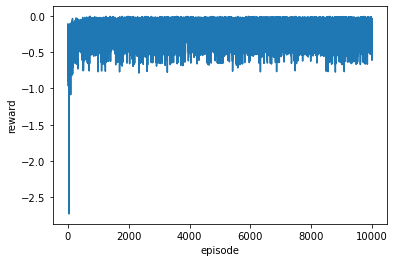

In [8]:
plt.plot(reward_res)
plt.xlabel("episode")
plt.ylabel("reward")
plt.show()

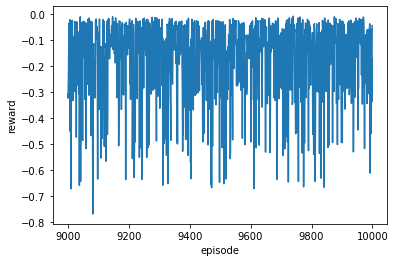

In [9]:
plt.plot(np.arange(len(reward_res))[-1000:], reward_res[-1000:])
plt.xlabel("episode")
plt.ylabel("reward")
plt.show()

In [10]:
reward_res

array([-0.54720158, -0.5635615 , -0.7118189 , ..., -0.16918816,
       -0.33769929, -0.04418738])

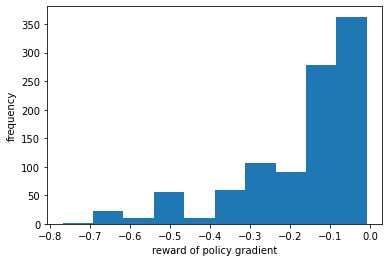

In [11]:
plt.hist(reward_res[-1000:])
plt.xlabel("reward of policy gradient")
plt.ylabel("frequency")
plt.show()

## delta hedging results

In [12]:
reward_delta_res, action_delta_res = a1.Delta_hedging(20000)

rewards [-0.65549633 -0.11273483 -0.20537622 ... -0.37466427 -0.13836441
 -1.05248075]


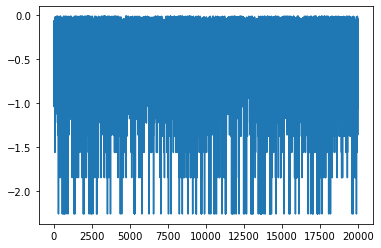

In [13]:
plt.plot(reward_delta_res)
plt.show()

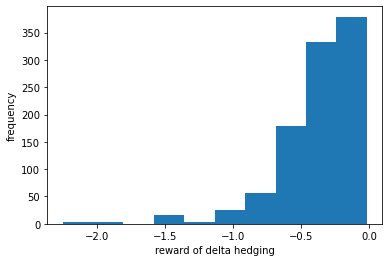

In [18]:
plt.hist(reward_delta_res[-1000:])
plt.xlabel("reward of delta hedging")
plt.ylabel("frequency")
plt.show()

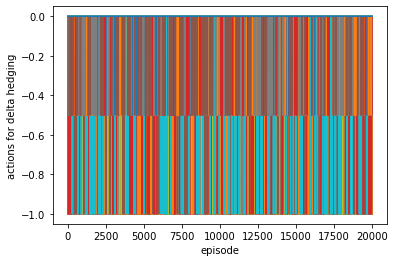

In [15]:
plt.plot(action_delta_res)
plt.xlabel("episode")
plt.ylabel("actions for delta hedging")
plt.show()

## Analyses on reward stability

### policy gradient 

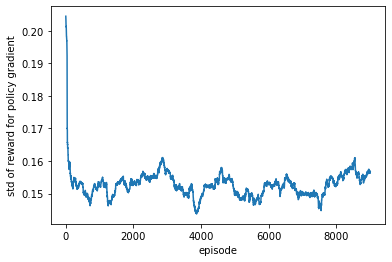

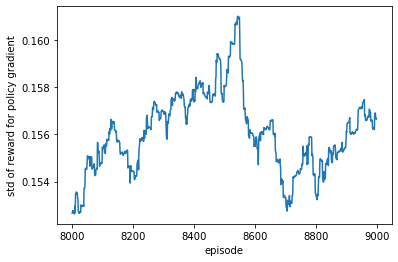

In [16]:
std_list = []
for i in range(1000, len(reward_res)):
    std_list.append(np.std(reward_res[i-1000:i]))
plt.plot(std_list[:])
plt.xlabel("episode")
plt.ylabel("std of reward for policy gradient")
plt.show()
plt.plot(np.arange(len(std_list))[-1000:], std_list[-1000:])
plt.xlabel("episode")
plt.ylabel("std of reward for policy gradient")
plt.show()

### delta hedging

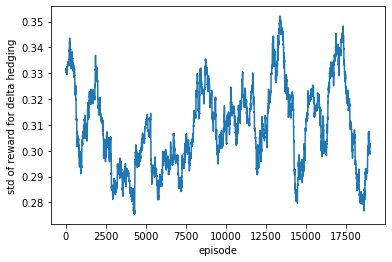

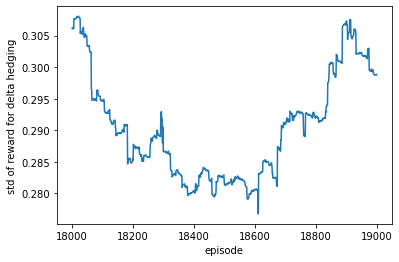

In [17]:
std_list = []
for i in range(1000, len(reward_delta_res)):
    std_list.append(np.std(reward_delta_res[i-1000:i]))
plt.plot(std_list[:])
plt.xlabel("episode")
plt.ylabel("std of reward for delta hedging")
plt.show()

plt.plot(np.arange(len(std_list))[-1000:], std_list[-1000:])
plt.xlabel("episode")
plt.ylabel("std of reward for delta hedging")
plt.show()